In [ ]:
# citations of orignals:
# """
# first two attempts were DCGANs (result were mode collapse)
# MNIST DCGAN by TensorFlow Authors: https://colab.research.google.com/github/tensorflow/docs/blob/master/site/en/tutorials/generative/dcgan.ipynb#scrollTo=ZBwyU6t2Wf3g
# Monet_ Dataset DCGAN architecture: https://www.kaggle.com/code/thuylinh225/generate-monet-images-using-dcgan
# naming convention for models: https://github.com/thashimoto1998/DCGAN/blob/master/dcgan.py
# """

## Library Setup

In [1]:
import glob
import imageio
import tensorflow as tf
import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import time
import matplotlib.image as mpimg

In [2]:
import pandas as pd
from torchvision.transforms import v2
import tensorflow.keras as keras
from tensorflow.keras import layers
from tensorflow.keras import optimizers
from tensorflow.keras.utils import plot_model
from tensorflow.keras.initializers import RandomNormal
from tensorflow.keras.models import Sequential, Model, load_model
from tensorflow.keras.layers import Conv2D, Conv2DTranspose, Dense, Flatten, Reshape
from tensorflow.keras.layers import BatchNormalization, Dropout
from tensorflow.keras.layers import ReLU, LeakyReLU, Activation
from tensorflow.keras.optimizers import Adam
!pip install tensorflow_docs
import tensorflow_docs.vis.embed as embed

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 182.5/182.5 kB 1.6 MB/s eta 0:00:00


## Device setup (Accelerator or CPU)

In [3]:
try:
    tpu = tf.distribute.cluster_resolver.TPUClusterResolver()
    print('Device:', tpu.master())
    tf.config.experimental_connect_to_cluster(tpu)
    tf.tpu.experimental.initialize_tpu_system(tpu)
    strategy = tf.distribute.TPUStrategy(tpu)
except Exception as e:
    print("can't initialize tpu, using default, exception: " + str(e))
    strategy = tf.distribute.get_strategy()
print('Number of replicas:', strategy.num_replicas_in_sync)

AUTOTUNE = tf.data.experimental.AUTOTUNE

can't initialize tpu, using default, exception: Please provide a TPU Name to connect to.
Number of replicas: 1


## Gather and prepare dataset

In [4]:
#Gather images
!git clone https://github.com/LyJacky/ImageGeneration.git

Cloning into 'ImageGeneration'...
remote: Enumerating objects: 414, done.
remote: Counting objects: 100% (109/109), done.
remote: Compressing objects: 100% (66/66), done.
remote: Total 414 (delta 43), reused 107 (delta 41), pack-reused 305
Receiving objects: 100% (414/414), 58.42 MiB | 21.34 MiB/s, done.
Resolving deltas: 100% (43/43), done.


In [5]:
# files = glob.glob(f"/content/ImageGeneration/monet_jpg/*.jpg")
data_path = glob.glob(f"/content/ImageGeneration/monet_jpg")

os.chdir(data_path[0])

data  = []
for file in os.listdir():
    if file.endswith(".jpg"):
        file_path = f"{data_path[0]}/{file}"
        img = mpimg.imread(file_path)
        data.append(img)

In [6]:
print(len(data))
print(data[0].shape)

300
(256, 256, 3)


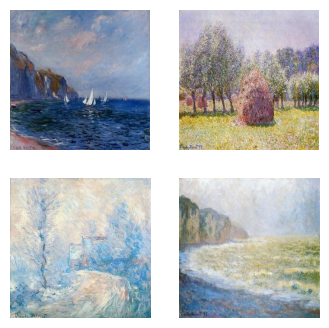

In [7]:
# show some samples

fig = plt.figure(figsize=(4,4))
for i, img in enumerate(data[0:4]):
    plt.subplot(2, 2, i+1)
    plt.imshow(data[i])
    plt.axis('off')
plt.show()

In [12]:
print(len(data))
print(data[0].shape)

300
(256, 256, 3)


In [9]:
BATCH_SIZE = 64
BUFFER_SIZE = 300

In [11]:
train_dataset = tf.data.Dataset.from_tensor_slices(data).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

## Generator



In [13]:
# modified generator

def make_generator_model():

    generator = Sequential(name="Generator")
    generator.add(Dense(16*16*512,
                        input_shape=(100,)))
    generator.add(Reshape((16,16,512)))

    # layer 2
    generator.add(Conv2DTranspose(filters=256, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 3
    generator.add(Conv2DTranspose(filters=128, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 4
    generator.add(Conv2DTranspose(filters=64, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #layer 5
    generator.add(Conv2DTranspose(filters=32, kernel_size=(6,6), strides=(2,2), padding='same'))
    generator.add(LeakyReLU(alpha=0.2))

    #output
    generator.add(Conv2DTranspose(3, kernel_size=(6,6), activation='tanh', strides=(1,1), padding='same'))

    return generator

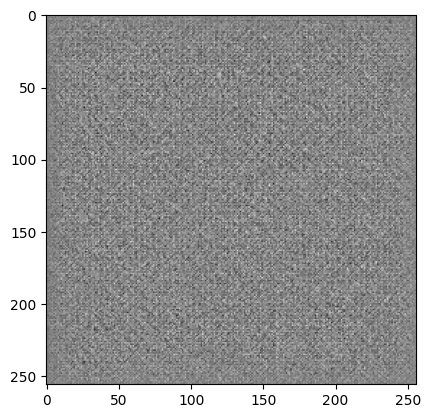

In [14]:
# create noisy image sample
with strategy.scope():
    generator = make_generator_model()
    noise = tf.random.normal([1, 100])
    generated_image = generator(noise, training=False)

plt.imshow(generated_image[0, :, :, 0], cmap='gray')

## Discriminator

In [15]:
# Discriminator
def make_discriminator_model():

    discriminator = Sequential()

    #layer 1
    discriminator.add(Conv2D(filters=32, kernel_size=(6,6), strides=(2, 2), padding='same', input_shape=[256, 256, 3]))
    discriminator.add(LeakyReLU(0.2))

    #layer 2
    discriminator.add(Conv2D(filters=64, kernel_size=(6,6), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    #layer 3
    discriminator.add(Conv2D(filters=128, kernel_size=(6,6), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    #layer 4
    discriminator.add(Conv2D(filters=256, kernel_size=(6,6), strides=(2, 2), padding='same'))
    discriminator.add(BatchNormalization())
    discriminator.add(LeakyReLU(0.2))

    # Flatten and Output Layers
    discriminator.add(Flatten())
    discriminator.add(Dropout(0.3))
    discriminator.add(Dense(1, activation='sigmoid'))
    # discriminator.add(Dense(1, activation='binary_crossentropy'))

    return discriminator


In [16]:
with strategy.scope():
    discriminator = make_discriminator_model()
    decision = discriminator(generated_image)
print (decision)

tf.Tensor([[0.50003356]], shape=(1, 1), dtype=float32)


In [17]:
# This method returns a helper function to compute cross entropy loss
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

## Loss Functions

In [18]:
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    total_loss = real_loss + fake_loss
    return total_loss

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

## Optimizers

In [19]:
with strategy.scope():
    generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

## Checkpoints and Processing Outputs

In [20]:
checkpoint_dir = '/content/training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [21]:
!mkdir ../../outputs
!mkdir ../../outputs/first-DCGAN

In [22]:
def generate_and_save_images(model, epoch, test_input):

  predictions = model(test_input, training=False)
  fig = plt.figure(figsize=(4, 4))

  for i in range(predictions.shape[0]):
      normalized_pred = predictions[i].numpy()
      normalized_pred = (normalized_pred[:, :, :] * 127.5 + 127.5).astype(np.uint8)
      plt.subplot(4, 4, i+1)
      plt.imshow(normalized_pred)
      plt.axis('off')

  plt.savefig('../../outputs/first-DCGAN/image_at_epoch_{:04d}.png'.format(epoch))
  plt.show()

## Train Method

In [23]:
def train(dataset, epochs):
  for epoch in range(epochs):
    start = time.time()

    for image_batch in dataset:
      train_step(image_batch)

    # Produce images for the GIF as you go
    generate_and_save_images(generator,
                             epoch + 1,
                             seed)
    # Debug: seed is Seed: tf.Tensor(2D rand num, shape(16,100))

    # Save the model every 15 epochs
    if (epoch + 1) % 15 == 0:
      checkpoint.save(file_prefix = checkpoint_prefix)

    print ('Time for epoch {} is {} sec'.format(epoch + 1, time.time()-start))

  # Generate after the final epoch
  generate_and_save_images(generator,
                           epochs,
                           seed)

In [24]:
noise_dim = 100
num_examples_to_generate = 16

# You will reuse this seed overtime (so it's easier)
# to visualize progress in the animated GIF)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# Notice the use of `tf.function`
# This annotation causes the function to be "compiled".
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
      generated_images = generator(noise, training=True)

      real_output = discriminator(images, training=True)
      fake_output = discriminator(generated_images, training=True)

      gen_loss = generator_loss(fake_output)
      disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

In [25]:
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))

In [28]:
#training loop
EPOCHS = 5

## Begin Training

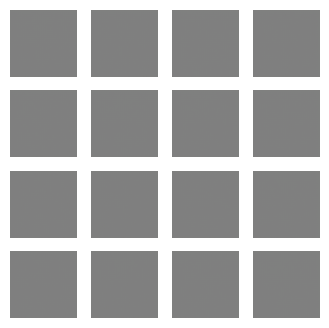

Time for epoch 1 is 4.772097826004028 sec


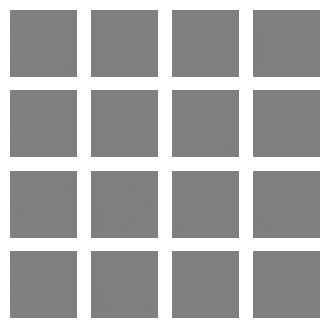

Time for epoch 2 is 5.0323755741119385 sec


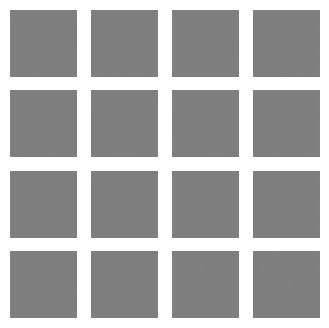

Time for epoch 3 is 4.89083194732666 sec


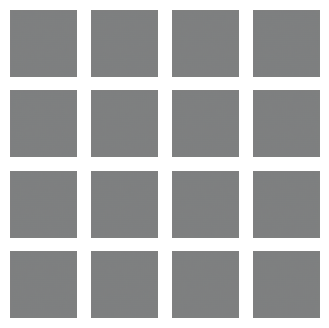

Time for epoch 4 is 4.716001749038696 sec


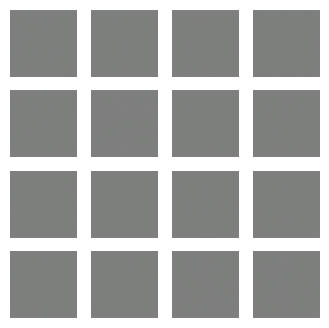

Time for epoch 5 is 4.745909929275513 sec


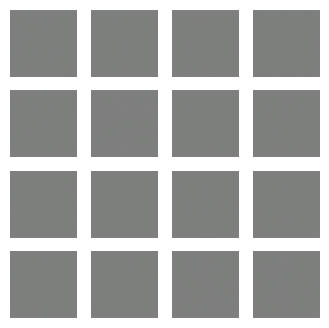

In [29]:
train(train_dataset, EPOCHS)

## Create GIF

In [ ]:
first_dcgan_file = 'first_dcgan.gif'

with imageio.get_writer(first_dcgan_file, mode='I') as writer:
  filenames = glob.glob('../../outputs/first-DCGAN/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-34-f853b05f63b1>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)


> Note: The following outputs was from a different training session where the outputs were got overwritten


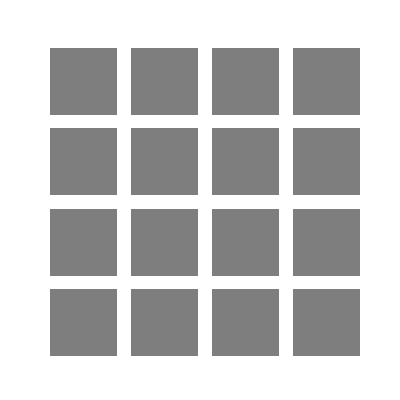

In [ ]:
embed.embed_file(first_dcgan_file)

In [ ]:
#############################
###    2nd DCGAN Attempt  ###
#############################

## Setup new Generator and Discriminator with optimizers
- Init noise dimension
- Init seed to visualize Generator progress

In [ ]:
generator2 = make_generator_model()
discriminator2 = make_discriminator_model()
with strategy.scope():
    generator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)
    discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=0.0002, beta_1=0.5)

noise_dim = 100
num_examples_to_generate = 25
seed = tf.random.normal([num_examples_to_generate, noise_dim])

In [ ]:
# !rm -r ../../outputs/second-DCGAN

In [ ]:
!mkdir ../../outputs/second-DCGAN

## Setup DCGAN

In [ ]:
class DCGAN_model:
    def __init__(self, noise_dim, EPOCHS, BATCH_SIZE, generator, discriminator, dataset):
        self.noise_dim = noise_dim
        self.EPOCHS = EPOCHS
        self.BATCH_SIZE = BATCH_SIZE
        self.generator = generator
        #self.discriminator = discriminator2
        self.dataset = dataset

    @tf.function
    def train(self, images):

    # Create random noise vector
        noise = tf.random.normal([images.shape[0], noise_dim])

        with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:

        # generate images use random noise vector
            generated_images = self.generator(noise, training=True)

            # use discriminator to evaluate the real and fake images
            real_output = discriminator(images, training=True)
            fake_output = discriminator(generated_images, training=True)
            # self.debug(real_output, fake_output)

            # compute generator loss and discriminator loss
            gen_loss = generator_loss(fake_output)
            disc_loss = discriminator_loss(real_output, fake_output)

            # Compute gradients
            gradients_of_generator = gen_tape.gradient(gen_loss, self.generator.trainable_variables)
            gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

            # Update optimizers
            generator_optimizer.apply_gradients(zip(gradients_of_generator, self.generator.trainable_variables))
            discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

        return (gen_loss + disc_loss) * 0.5

    @tf.function
    def distributed_train(self, images):
        per_replica_losses = strategy.run(self.train, args=(images,))
        return strategy.reduce(tf.distribute.ReduceOp.MEAN, per_replica_losses, axis=None)

    def generate_images(self):
        noise = tf.random.normal([self.BATCH_SIZE, self.noise_dim])
        predictions = self.generator.predict(noise)
        return predictions

    def generate_and_plot_images(self, epoch):
        # image = self.generate_images()
        predictions = self.generator.predict(seed)

        gen_imgs = 0.5 * predictions + 0.5
        fig = plt.figure(figsize=(5, 5))
        for i in range(25):
            plt.subplot(5, 5, i+1)
            plt.imshow(gen_imgs[i, :, :, :])
            plt.axis('off')
            plt.savefig('../../outputs/second-DCGAN/image_at_epoch_{:04d}.png'.format(epoch))
        plt.show()

    def save_images_with_seed_for_gif(self, epoch):
        predictions = self.generator.predict(seed)

        gen_imgs = 0.5 * predictions + 0.5
        # fig = plt.figure(figsize=(10, 10))
        # fig = plt.figure(figsize=(5, 5))
        for i in range(25):
            # plt.subplot(5, 5, i+1)
            plt.imshow(gen_imgs[i, :, :, :])
            # plt.axis('off')
            plt.savefig('../../outputs/second-DCGAN/image_at_epoch_{:04d}.png'.format(epoch))

    def train_loop(self):
        e_ls = []
        mean_ls = []
        for epoch in range(self.EPOCHS):
            start = time.time()

            total_loss = 0.0
            num_batches = 0

            for image_batch in self.dataset:
                loss = self.distributed_train(image_batch)
                total_loss += tf.reduce_mean(loss)
                num_batches += 1
            mean_loss = total_loss / num_batches

            # if (epoch+1) % 5 == 0:
            #     self.save_images_with_seed_for_gif(epoch)

            self.generate_and_plot_images(epoch)

            if (epoch+1) % 5 == 0:
                print('Time for epoch {} is {} sec, mean loss is {}'.format(epoch + 1, time.time()-start, mean_loss))

                e_ls.append(epoch+1)
                mean_ls.append(mean_loss)
        print("\nMean Loss for every 20 epochs: \n")
        table = pd.DataFrame({"Epoch": e_ls, "Mean Loss": np.array(mean_ls)})
        return table

In [ ]:
#training loop
EPOCHS = 300

## Begin DCGAN Training


In [ ]:
# train, visualize and print out the result for DCGAN model
gan1 = DCGAN_model(noise_dim, EPOCHS, BATCH_SIZE, generator2, discriminator2, train_dataset)
res1 = gan1.train_loop()

In [ ]:
res1

,Epoch,Mean Loss
0,5,6.622096
1,10,20.672092
2,15,14.054237
3,20,10.495397
4,25,2.156735
5,30,2.713376
6,35,2.847812
7,40,2.779436
8,45,6.543433
9,50,1.836165


## Create GIF

In [ ]:
second_dcgan_file = 'second_dcgan.gif'

with imageio.get_writer(second_dcgan_file, mode='I') as writer:
  filenames = glob.glob('../../outputs/second-DCGAN/image*.png')
  filenames = sorted(filenames)
  for filename in filenames:
    image = imageio.imread(filename)
    writer.append_data(image)

<ipython-input-36-61fe5fd33e66>:7: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  image = imageio.imread(filename)



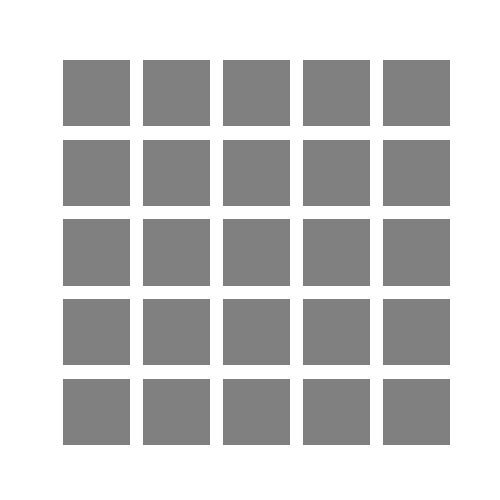

In [ ]:
embed.embed_file(second_dcgan_file)